Questions
Presenting the insight in a way that opens new perspectives on the data is most important, it unveils interesting patterns never seen before. What are the driving parameters of police killings?
(Data provided has null components so data cleansing must be done)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import folium
import datetime as dt
data = pd.read_csv('police_killings.csv',encoding = 'ISO-8859-1')
data = data.dropna()

In [3]:
#folium Map
#Map = folium.Map(location=[32.529577,-86.362829], zoom_start=4)

#filter to by black people
datablack = data[data['raceethnicity'] == 'Black']
#datablack.apply(lambda row: folium.Marker(location=[row['latitude'], row['longitude']],popup=row['name'], icon=folium.Icon(color = 'black', icon='info-sign')).add_to(Map), axis=1)

#filter by white people 
datawhite = data[data['raceethnicity'] == 'White']
#datawhite.apply(lambda row: folium.Marker(location=[row['latitude'], row['longitude']],popup=row['name'], icon=folium.Icon(color = 'white', icon='info-sign', icon_color ='Black')).add_to(Map), axis=1)

#filter by asian people 
dataasian = data[data['raceethnicity'] == 'Asian/Pacific Islander']
#dataasian.apply(lambda row: folium.Marker(location=[row['latitude'], row['longitude']],popup=row['name'], icon=folium.Icon(color = 'orange')).add_to(Map), axis=1)

#filter by latino people 
datalatino = data[data['raceethnicity'] == 'Hispanic/Latino']
#datalatino.apply(lambda row: folium.Marker(location=[row['latitude'], row['longitude']],popup=row['name'], icon=folium.Icon(color = 'gray')).add_to(Map), axis=1)

#filter by native american people 
datanative = data[data['raceethnicity'] == 'Native American']
#datanative.apply(lambda row: folium.Marker(location=[row['latitude'], row['longitude']],popup=row['name'], icon=folium.Icon(color = 'red')).add_to(Map), axis=1)

In [4]:
data['pov']= data['pov'].astype(float)
data['state_fp'] = data['state_fp'].astype(str)
data['county_fp'] = data['county_fp'].astype(str)
data['share_white'] = data['share_white'].astype(float)
data['share_black'] = data['share_black'].astype(float)
data['share_hispanic'] = data['share_hispanic'].astype(float)
#decimal shared population
#= data['share_white']/100

#correction of FIPS code
m1 = data['state_fp'].str.len().max()
data['state_fp'] = data['state_fp'].str.rjust(m1, fillchar='0')
m2 = data['county_fp'].str.len().max()
data['county_fp'] = data['county_fp'].str.rjust(m2, fillchar='0')

Section 1: Visualization of data sets using folium
(All maps are showing the region shaded with different aspects such as poverty, un-employment, college and etc)
The White Button on the upper-right of the map can be used to see map with different aspects

In [5]:
import os
import json
states = os.path.join('map_latest_new.json')

# cur_json = json.load(open(states, encoding='ISO-8859-1'))

# path,ext = os.path.splitext(states)
# new_path =path+"_new"+ext
# with open(new_path,"w", encoding='utf-8') as jsonfile:
#         json.dump(cur_json,jsonfile,ensure_ascii=False)
# us_county = gpd.read_file('./States.json', driver='GeoJSON')
# map    
map_choropleth = folium.Map(location=[39.77, -86.15], zoom_start=4)
#cases occured

#mark black people
fg_black = folium.FeatureGroup(name = 'Black People Died')
for lat,lon,city in zip(datablack['latitude'],datablack['longitude'],datablack['city']):
    fg_black.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'black', icon='info-sign')))
map_choropleth.add_child(fg_black)

#mark White people    
fg_white = folium.FeatureGroup(name = 'White People Died')
for lat,lon,city in zip(datawhite['latitude'],datawhite['longitude'],datawhite['city']):
    fg_white.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'white', icon='info-sign', icon_color ='Black')))
map_choropleth.add_child(fg_white)

#mark asian people    
fg_asian = folium.FeatureGroup(name = 'Asian People Died')
for lat,lon,city in zip(dataasian['latitude'],dataasian['longitude'],dataasian['city']):
    fg_asian.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'orange', icon='info-sign', icon_color ='Black')))
map_choropleth.add_child(fg_asian)

#mark latino people    
fg_latino = folium.FeatureGroup(name = 'Latino People Died')
for lat,lon,city in zip(datalatino['latitude'],datalatino['longitude'],datalatino['city']):
    fg_latino.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'blue', icon='info-sign', icon_color ='Black')))
map_choropleth.add_child(fg_latino)

#mark native american people    
fg_native = folium.FeatureGroup(name = 'Native American People Died')
for lat,lon,city in zip(datanative['latitude'],datanative['longitude'],datanative['city']):
    fg_native.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'red', icon='info-sign', icon_color ='Black')))
map_choropleth.add_child(fg_native)




# choropleth population
folium.Choropleth(
    geo_data=states,
    name='choropleth population',
    data=data,
    columns=['county_fp','pop'],
    # see folium.Choropleth? for details on key_on
    key_on='feature.properties.COUNTY',
    fill_color='YlGn',
    fill_opacity=0.5,
    line_opacity=0.5,
    legend_name='Population',
    highlight=True
).add_to(map_choropleth)

# choropleth pov
folium.Choropleth(
    geo_data=states,
    name='choropleth poverty',
    data=data,
    columns=['county_fp','pov'],
    # see folium.Choropleth? for details on key_on
    key_on='feature.properties.COUNTY',
    fill_color='RdPu',
    fill_opacity=0.5,
    line_opacity=0.5,
    legend_name='Poverty Rate',
    highlight=True
).add_to(map_choropleth)

# choropleth un-employment rate
folium.Choropleth(
    geo_data=states,
    name='choropleth un-employment rate',
    data=data,
    columns=['county_fp','urate'],
    # see folium.Choropleth? for details on key_on
    key_on='feature.properties.COUNTY',
    fill_color='OrRd',
    fill_opacity=0.5,
    line_opacity=0.5,
    legend_name='Un-Employment rate',
    highlight=True
).add_to(map_choropleth)

# choropleth college rate
folium.Choropleth(
    geo_data=states,
    name='choropleth college rate',
    data=data,
    columns=['county_fp','college'],
    # see folium.Choropleth? for details on key_on
    key_on='feature.properties.COUNTY',
    fill_color='RdPu',
    fill_opacity=0.5,
    line_opacity=0.5,
    legend_name='College %',
    highlight=True
).add_to(map_choropleth)

map_choropleth.add_child(folium.LayerControl())
map_choropleth

In [6]:
#county by races population
map1 = folium.Map(location=[39.77, -86.15], zoom_start=4)

#data.apply(lambda row: folium.Circle(radius=row['share_white'], location=[row['latitude'],row['longitude']]).add_to(map1), axis=1)
#data.apply(lambda row: folium.CircleMarker(location=[row['latitude'], row['longitude']], color='blue', fill_color='yellow', radius=row['share_white']/10).add_to(map1), axis=1)

#mark black people
fg_black = folium.FeatureGroup(name = 'Black People Died')
for lat,lon,city in zip(datablack['latitude'],datablack['longitude'],datablack['city']):
    fg_black.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'black', icon='info-sign')))
map1.add_child(fg_black)

#mark White people    
fg_white = folium.FeatureGroup(name = 'White People Died')
for lat,lon,city in zip(datawhite['latitude'],datawhite['longitude'],datawhite['city']):
    fg_white.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'white', icon='info-sign', icon_color ='Black')))
map1.add_child(fg_white)

#mark asian people    
fg_asian = folium.FeatureGroup(name = 'Asian People Died')
for lat,lon,city in zip(dataasian['latitude'],dataasian['longitude'],dataasian['city']):
    fg_asian.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'orange', icon='info-sign', icon_color ='Black')))
map1.add_child(fg_asian)

#mark latino people    
fg_latino = folium.FeatureGroup(name = 'Latino People Died')
for lat,lon,city in zip(datalatino['latitude'],datalatino['longitude'],datalatino['city']):
    fg_latino.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'blue', icon='info-sign', icon_color ='Black')))
map1.add_child(fg_latino)

#mark native american people    
fg_native = folium.FeatureGroup(name = 'Native American People Died')
for lat,lon,city in zip(datanative['latitude'],datanative['longitude'],datanative['city']):
    fg_native.add_child(folium.Marker(location=[lat,lon],popup=(folium.Popup(city)), icon=folium.Icon(color = 'red', icon='info-sign', icon_color ='Black')))
map1.add_child(fg_native)

#REGIONS
fgW = folium.FeatureGroup(name = 'White_Pop')
for lat,lon,pop in zip(data['latitude'],data['longitude'],data['share_white']):
    fgW.add_child(folium.Circle(radius=pop*1000,location=[lat,lon],popup=(folium.Popup("White :"+str(pop))), fill_color='blue',fill_opacity=0.5))
map1.add_child(fgW)

fgB = folium.FeatureGroup(name = 'Black_Pop')
for lat,lon,pop in zip(data['latitude'],data['longitude'],data['share_black']):
    fgB.add_child(folium.Circle(radius=pop*1000,location=[lat,lon],popup=(folium.Popup("Black :"+str(pop))), fill_color='red',fill_opacity=0.5))
map1.add_child(fgB) 

fgH = folium.FeatureGroup(name = 'Hispanic_Pop')
for lat,lon,pop in zip(data['latitude'],data['longitude'],data['share_hispanic']):
    fgH.add_child(folium.Circle(radius=pop*100,location=[lat,lon],popup=(folium.Popup("Hispanic :"+str(pop))), fill_color='green',fill_opacity=0.5))
map1.add_child(fgH) 

map1.add_child(folium.LayerControl())
map1

In [7]:
# choroplet map of county_income and county_bucket

map2 = folium.Map(location=[39.77, -86.15], zoom_start=4)

# choropleth county income
folium.Choropleth(
    geo_data=states,
    name='choropleth County_income',
    data=data,
    columns=['county_fp','county_income'],
    # see folium.Choropleth? for details on key_on
    key_on='feature.properties.COUNTY',
    fill_color='RdPu',
    fill_opacity=1,
    line_opacity=1,
    legend_name='HouseHold Income',
    highlight=True
).add_to(map2)

# choropleth county bucket
folium.Choropleth(
    geo_data=states,
    name='choropleth County_Bucket',
    data=data,
    columns=['county_fp','county_bucket'],
    # see folium.Choropleth? for details on key_on
    key_on='feature.properties.COUNTY',
    fill_color='YlGnBu',
    fill_opacity=1,
    line_opacity=1,
    legend_name='Bucket',
    highlight=True
).add_to(map2)
map2.add_child(folium.LayerControl())
map2


Section 2: Analysis with matplotlib

<function matplotlib.pyplot.show(close=None, block=None)>

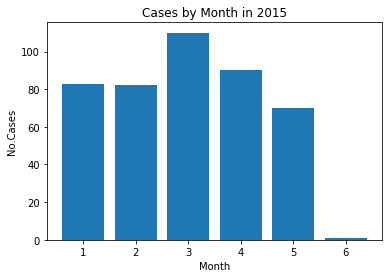

In [8]:
data_cases = pd.DataFrame(data.groupby('month')['name'].count()).reset_index()
data_cases.columns = ['Month','No.Cases']
data_cases['Month'] = pd.to_datetime(data_cases.Month,format='%B', errors='coerce').dt.month
data_cases.sort_values(by="Month")

plt.bar(data_cases['Month'], data_cases['No.Cases'])
plt.ylabel('No.Cases')
plt.xlabel('Month')
plt.title('Cases by Month in 2015')
plt.show

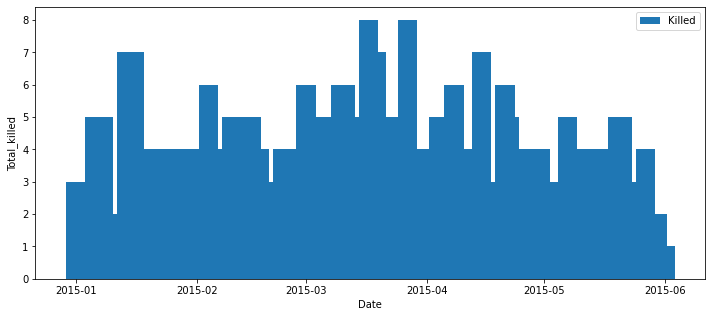

In [9]:
#Police killing from january to june 2015
data['date'] = data['day'].astype(str) +'-'+ data['month']+'-'+ data['year'].astype(str)
data['date'] = pd.to_datetime(data['date'], format = '%d-%B-%Y')

timeserieskills = pd.DataFrame(data.groupby('date').name.count()).reset_index()
timeserieskills.columns = ['Date','Total_Killed']
timeserieskills

plt.figure(figsize=(12,5))
plt.bar(timeserieskills.Date,timeserieskills.Total_Killed,width=5, label = 'Killed')
plt.xlabel('Date')
plt.ylabel('Total_killed')
plt.legend()
plt.show()

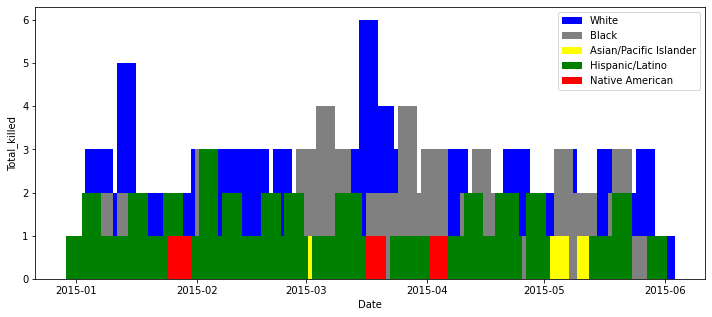

In [10]:
# Police killing by races

#filter to by black people
datablack = data[data['raceethnicity'] == 'Black']
black = pd.DataFrame(datablack.groupby('date').name.count()).reset_index()
black.columns = ['Date','Total_Killed']

#filter by white people 
datawhite = data[data['raceethnicity'] == 'White']
white = pd.DataFrame(datawhite.groupby('date').name.count()).reset_index()
white.columns = ['Date','Total_Killed']

#filter by asian people 
dataasian = data[data['raceethnicity'] == 'Asian/Pacific Islander']
asian = pd.DataFrame(dataasian.groupby('date').name.count()).reset_index()
asian.columns = ['Date','Total_Killed']

#filter by latino people 
datalatino = data[data['raceethnicity'] == 'Hispanic/Latino']
latino = pd.DataFrame(datalatino.groupby('date').name.count()).reset_index()
latino.columns = ['Date','Total_Killed']

#filter by native american people 
datanative = data[data['raceethnicity'] == 'Native American']
native = pd.DataFrame(datanative.groupby('date').name.count()).reset_index()
native.columns = ['Date','Total_Killed']


#plt bar chart
plt.figure(figsize=(12,5))
plt.bar(white.Date,white.Total_Killed,width=5, color='blue',label = 'White')
plt.bar(black.Date,black.Total_Killed,width=5, color='gray',label = 'Black')
plt.bar(asian.Date,asian.Total_Killed,width=5, color='yellow',label = 'Asian/Pacific Islander')
plt.bar(latino.Date,latino.Total_Killed,width=5, color='green',label = 'Hispanic/Latino')
plt.bar(native.Date,native.Total_Killed,width=5, color='red',label = 'Native American')
plt.xlabel('Date')
plt.ylabel('Total_killed')
plt.legend()
plt.show()

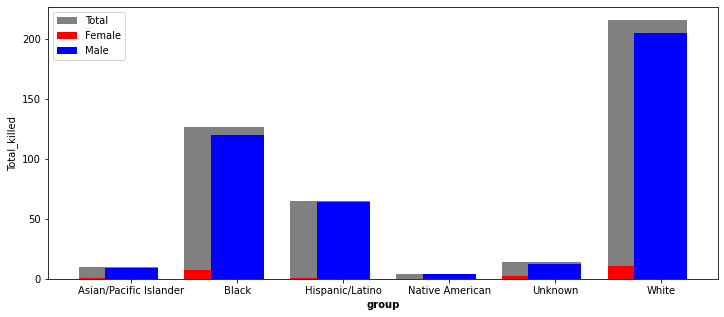

In [11]:
#by gender
df_race_gender = pd.DataFrame(data.groupby(['raceethnicity','gender']).name.count()).reset_index()
df = pd.DataFrame({"raceethnicity":'Native American',"gender":'Female',"name":[0]})
df_race_gender = (df_race_gender.append(df).reset_index(drop=True)).groupby(['raceethnicity','gender']).name.sum().reset_index()
df_race_gender_female = df_race_gender[df_race_gender.gender == 'Female']
df_race_gender_male = df_race_gender[df_race_gender.gender == 'Male']

df_race = pd.DataFrame(df_race_gender.groupby('raceethnicity').name.sum()).reset_index()
barWidth = 0.25
 
# set height of bar
bars1 = df_race_gender_female.name
bars2 = df_race_gender_male.name

r1 = np.arange(6)
r2 = [x + barWidth for x in r1]
r3 = (r1+r2)/2

plt.figure(figsize=(12,5))
plt.bar(r3,df_race.name, color = 'grey', width =barWidth*3, label ='Total')
plt.bar(r1, bars1, color='red', width=barWidth*2, label='Female')
plt.bar(r2, bars2, color='blue', width=barWidth*2, label='Male')
plt.ylabel('Total_killed')
plt.xlabel('group', fontweight='bold')
plt.xticks([r + barWidth for r in range(len(bars1))], df_race_gender_female.raceethnicity )
plt.legend()
plt.show()

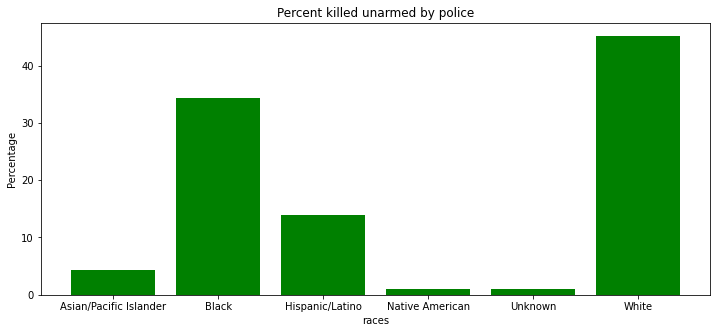

In [12]:
#figure for killed unarmed
df_unarm = data[data['armed'] == 'No']

df = pd.DataFrame(df_unarm.groupby('raceethnicity').armed.count()).reset_index()
df['percent'] = (df['armed']/93)*100

plt.figure(figsize=(12,5))
plt.bar(df.raceethnicity,df.percent, color = 'green')
plt.title('Percent killed unarmed by police')
plt.ylabel('Percentage')
plt.xlabel('races')
plt.show()

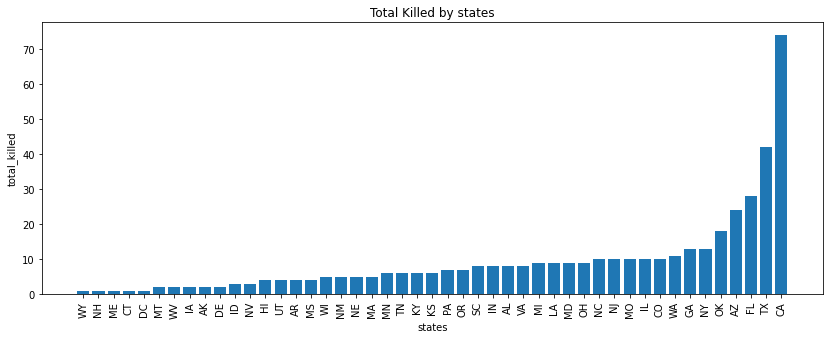

In [13]:
#figure for kill by states

#groupby states and sort increasing orders
df_states = pd.DataFrame(data.groupby('state').name.count().sort_values()).reset_index()

#top states killed people
plt.figure(figsize=(14,5))
plt.bar(df_states['state'],df_states['name'], width = 0.8)
plt.title('Total Killed by states')
plt.xlabel('states')
plt.ylabel('total_killed')
plt.xticks(rotation = '90')
plt.show()

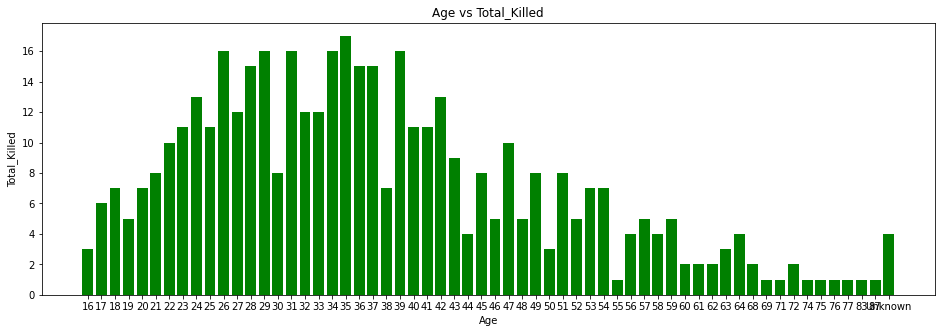

the average age killed 37.166666666666664


In [14]:
#age killed by police

df_age = pd.DataFrame(data.groupby('age').name.count()).reset_index()


plt.figure(figsize = (16,5))
plt.bar(df_age.age,df_age.name, width=0.8, color= 'green')
plt.title('Age vs Total_Killed')
plt.ylabel('Total_Killed')
plt.xlabel('Age')
#plt.xticks(rotation = '90')
plt.show()

average_age = data[data['age'] != 'Unknown'].age.astype(int).mean()
print('the average age killed '+str(average_age))

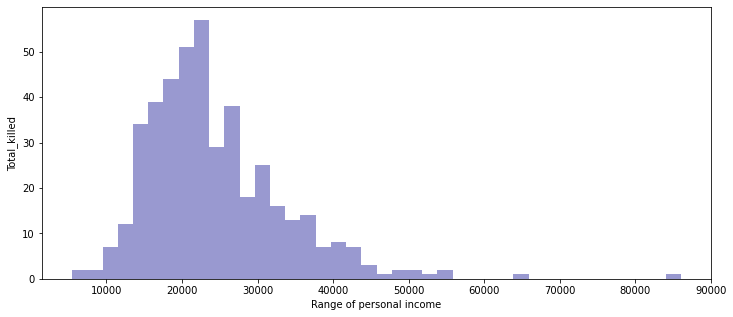

The average personal income 24358.311926605504


In [15]:
#victim personal income
df_personal = pd.DataFrame(data.groupby('p_income').name.count()).reset_index()
p =np.array(data.p_income).astype(float)

plt.figure(figsize=(12,5))
plt.hist(p,alpha=.4, color = 'darkblue', bins=40)
plt.xlabel('Range of personal income')
plt.ylabel('Total_killed')
plt.show()
average_p_income = p.mean()
print('The average personal income '+str(average_p_income))

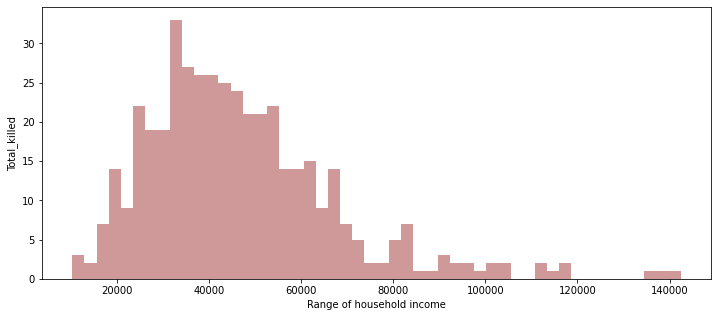

The average household income 46732.62614678899
The median household income 42770.5
The standard median household income 51171.0


In [16]:
#victim household income
df_personal = pd.DataFrame(data.groupby('h_income').name.count()).reset_index()
h =np.array(data.h_income).astype(float)

plt.figure(figsize=(12,5))
plt.hist(h, alpha=.4, color = 'darkred', bins=50)
plt.xlabel('Range of household income')
plt.ylabel('Total_killed')
plt.show()
average_h_income = h.mean()
print('The average household income '+str(average_h_income))
median_h_income = data.h_income.median()
print('The median household income '+str(median_h_income))
standard_median =data.county_income.median()
print('The standard median household income '+str(standard_median))

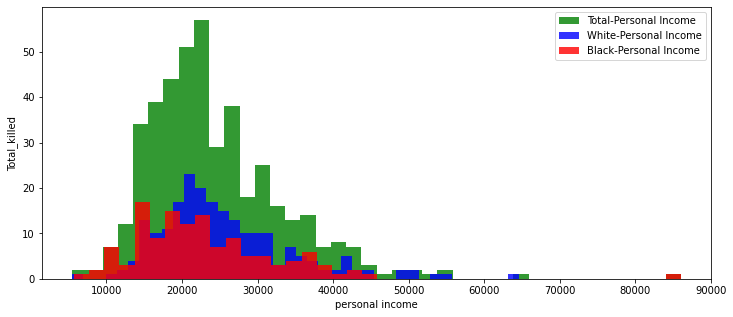

The average personal income 24358.311926605504
The average black personal income 23021.582677165356
The average white personal income 25606.925925925927


In [17]:
#since in US the major races was black and white, and the death are more into black and white so the further investigation are for them 
#personal income base on races
df_personal_black = pd.DataFrame(datablack.groupby('p_income').name.count()).reset_index()
black =np.array(datablack.p_income).astype(float)

df_personal_white = pd.DataFrame(datawhite.groupby('p_income').name.count()).reset_index()
white =np.array(datawhite.p_income).astype(float)

plt.figure(figsize=(12,5))
plt.hist(p, alpha=.8, color = 'green', bins=40,label = 'Total-Personal Income')
plt.hist(white, alpha=.8, color = 'blue', bins=40,label = 'White-Personal Income')
plt.hist(black, alpha=.8, color = 'red', bins=40,label = 'Black-Personal Income')
plt.xlabel('personal income')
plt.ylabel('Total_killed')
plt.legend()
plt.show()
average_p_income = p.mean()
print('The average personal income '+str(average_p_income))
average_p_income = black.mean()
print('The average black personal income '+str(average_p_income))
average_p_income = white.mean()
print('The average white personal income '+str(average_p_income))

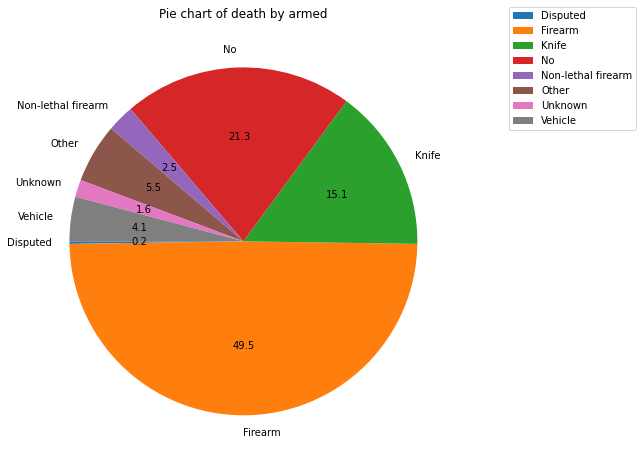

In [18]:
#overall status armed
data_armed = pd.DataFrame(data.groupby('armed').name.count()).reset_index()

plt.figure(figsize=(12,8))
plt.pie(data_armed.name, labels = data_armed.armed, autopct = '%.1f',startangle=180 )
plt.title('Pie chart of death by armed')
plt.legend(bbox_to_anchor = (1.1,1.05))
plt.show()

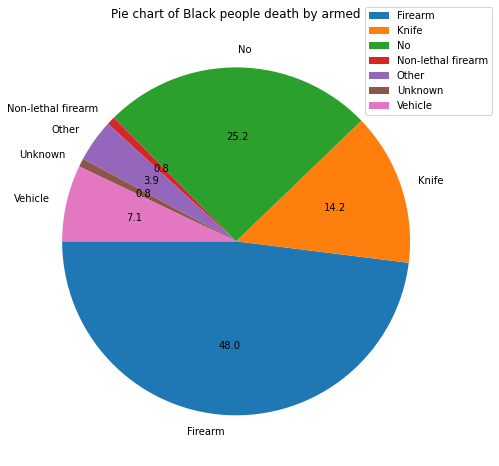

In [19]:
#black people death by armed
data_armed_black= pd.DataFrame(datablack.groupby('armed').name.count()).reset_index()
plt.figure(figsize=(12,8))
plt.pie(data_armed_black.name, labels = data_armed_black.armed, autopct = '%.1f',startangle=180 )
plt.title('Pie chart of Black people death by armed')
plt.legend(bbox_to_anchor = (1.1,1.05))
plt.show()

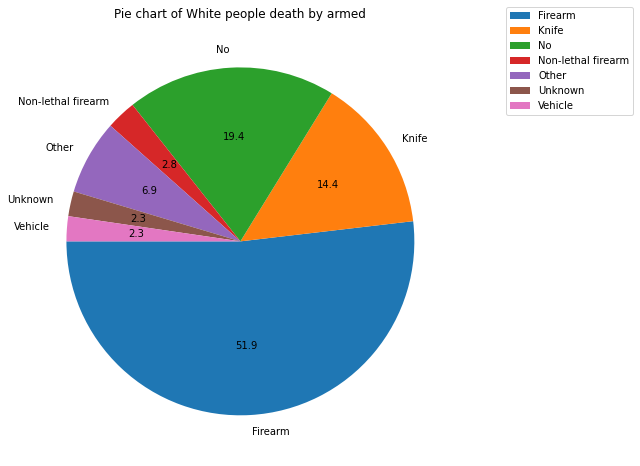

In [20]:
#white people death by armed
data_armed_white= pd.DataFrame(datawhite.groupby('armed').name.count()).reset_index()
plt.figure(figsize=(12,8))
plt.pie(data_armed_white.name, labels = data_armed_white.armed, autopct = '%.1f',startangle=180 )
plt.title('Pie chart of White people death by armed')
plt.legend(bbox_to_anchor = (1.1,1.05))
plt.show()

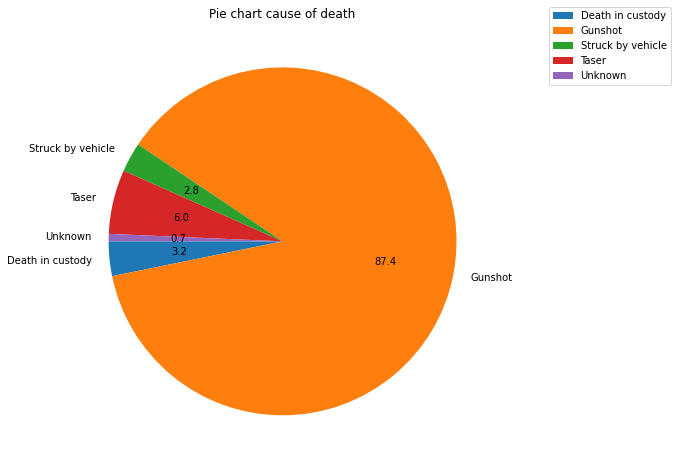

In [21]:
#cause of death
df_cause_death = pd.DataFrame(data.groupby('cause').name.count()).reset_index()
plt.figure(figsize=(12,8))
plt.pie(df_cause_death.name, labels = df_cause_death.cause, autopct = '%.1f',startangle=180 )
plt.title('Pie chart cause of death')
plt.legend(bbox_to_anchor = (1.1,1.05))
plt.show()

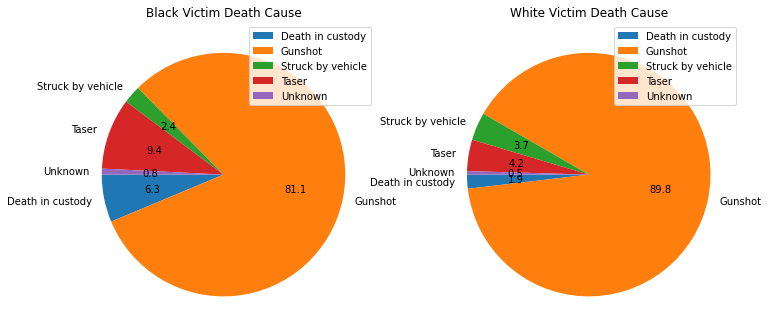

In [22]:
# black and white cause of death
df_death_black = pd.DataFrame(datablack.groupby('cause').name.count()).reset_index()

df_death_white = pd.DataFrame(datawhite.groupby('cause').name.count()).reset_index()

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,8))
ax1.pie(df_death_black.name, labels = df_death_black.cause, autopct = '%.1f',startangle=180 )
ax1.set_title('Black Victim Death Cause')
ax1.legend()

ax2.pie(df_death_white.name, labels = df_death_white.cause, autopct = '%.1f',startangle=180 )
ax2.set_title('White Victim Death Cause')
ax2.legend()
plt.show()